In [28]:
# Instalação de bibliotecas para preparação dos dados
!pip install numpy
!pip install pandas
!pip install matplotlib
!pip install seaborn
!pip install dataprep
!pip install sklearn

     |████████████████████████████████| 7.2MB 4.3MB/s eta 0:00:01
  Stored in directory: /Users/raphacgil/Library/Caches/pip/wheels/76/03/bb/589d421d27431bcd2c6da284d5f2286c8e3b2ea3cf1594c074
Successfully built sklearn


In [29]:
## Import de bibliotecas
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from dataprep.eda import *

In [11]:
# Leitura do arquivo
df = pd.read_csv('./fonte/BankChurners.csv')

## Remoção de colunas para preparação de estatísticas

In [17]:
df = df.drop(['CLIENTNUM',
         'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2',
         'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1'], axis=1)

In [33]:
df1 = df.loc[df['Attrition_Flag'] == 'Attrited Customer']
df2 = df.loc[df['Attrition_Flag'] == 'Existing Customer']
df1.head()

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
21,Attrited Customer,62,F,0,Graduate,Married,Less than $40K,Blue,49,2,3,3,1438.3,0,1438.3,1.047,692,16,0.600,0.000
39,Attrited Customer,66,F,0,Doctorate,Married,Unknown,Blue,56,5,4,3,7882.0,605,7277.0,1.052,704,16,0.143,0.077
51,Attrited Customer,54,F,1,Graduate,Married,Less than $40K,Blue,40,2,3,1,1438.3,808,630.3,0.997,705,19,0.900,0.562
54,Attrited Customer,56,M,2,Graduate,Married,$120K +,Blue,36,1,3,3,15769.0,0,15769.0,1.041,602,15,0.364,0.000
61,Attrited Customer,48,M,2,Graduate,Married,$60K - $80K,Silver,35,2,4,4,34516.0,0,34516.0,0.763,691,15,0.500,0.000


In [30]:
df.describe()

,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
count,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000
mean,46.325960,2.346203,35.928409,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,4404.086304,64.858695,0.712222,0.274894
std,8.016814,1.298908,7.986416,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,3397.129254,23.472570,0.238086,0.275691
min,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000
25%,41.000000,1.000000,31.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,2155.500000,45.000000,0.582000,0.023000
50%,46.000000,2.000000,36.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,3899.000000,67.000000,0.702000,0.176000
75%,52.000000,3.000000,40.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,4741.000000,81.000000,0.818000,0.503000
max,73.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,18484.000000,139.000000,3.714000,0.999000


In [31]:
df1.describe()

,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
count,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000,1627.000000
mean,46.659496,2.402581,36.178242,3.279656,2.693301,2.972342,8136.039459,672.822987,7463.216472,0.694277,3095.025814,44.933620,0.554386,0.162475
std,7.665652,1.275010,7.796548,1.577782,0.899623,1.090537,9095.334105,921.385582,9109.208129,0.214924,2308.227629,14.568429,0.226854,0.264458
min,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000
25%,41.000000,2.000000,32.000000,2.000000,2.000000,2.000000,2114.000000,0.000000,1587.000000,0.544500,1903.500000,37.000000,0.400000,0.000000
50%,47.000000,2.000000,36.000000,3.000000,3.000000,3.000000,4178.000000,0.000000,3488.000000,0.701000,2329.000000,43.000000,0.531000,0.000000
75%,52.000000,3.000000,40.000000,5.000000,3.000000,4.000000,9933.500000,1303.500000,9257.500000,0.856000,2772.000000,51.000000,0.692000,0.231000
max,68.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,1.492000,10583.000000,94.000000,2.500000,0.999000


## Geração de info sobre os dados coletados

/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: Fu

  0%|          | 0/2624 [00:00<?, ?it/s]

/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)


DataPrep Report
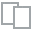
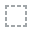
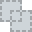
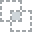
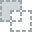
...
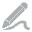
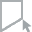
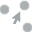
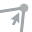
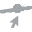

In [35]:
create_report(df1)

/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: Fu

  0%|          | 0/2624 [00:00<?, ?it/s]

/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)
/anaconda3/lib/python3.7/site-packages/dask/dataframe/accessor.py:48: FutureWarning: The default value of regex will change from True to False in a future version.
  out = getattr(getattr(obj, accessor, obj), attr)(*args, **kwargs)


DataPrep Report
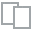
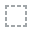
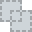
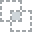
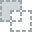
...
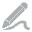
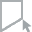
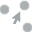
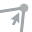
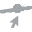

In [34]:
create_report(df2)

### 4 - Treinamento

In [75]:
# Remover features que não serão necessárias

df_clean = df.drop(['Dependent_count',
         'Months_on_book',
         'Contacts_Count_12_mon',
         'Total_Revolving_Bal',
         'Avg_Open_To_Buy',
         'Total_Amt_Chng_Q4_Q1',
         'Total_Trans_Amt',
         'Total_Trans_Amt',
         'Total_Trans_Ct',
         'Total_Ct_Chng_Q4_Q1',
         'Card_Category',
         'Income_Category',
         'Marital_Status' ], axis = 1) 

In [76]:
df_clean.head()

,Attrition_Flag,Customer_Age,Gender,Education_Level,Total_Relationship_Count,Months_Inactive_12_mon,Credit_Limit,Avg_Utilization_Ratio
0,Existing Customer,45,M,High School,5,1,12691.0,0.061
1,Existing Customer,49,F,Graduate,6,1,8256.0,0.105
2,Existing Customer,51,M,Graduate,4,1,3418.0,0.000
3,Existing Customer,40,F,High School,3,4,3313.0,0.760
4,Existing Customer,40,M,Uneducated,5,1,4716.0,0.000


In [97]:
# Escalonar features

df_clean.Attrition_Flag.replace({'Existing Customer': 1, 'Attrited Customer': 0}, inplace=True)
df_clean.Gender.replace({'F': 0, 'M': 1}, inplace=True)
df_clean.Education_Level.replace({'Graduate': 0, 'High School': 1, 'Unknown': 2,'Uneducated':3,'College':4,'Post-Graduate':5,'Doctorate':6}, inplace=True)


In [98]:
df_clean.head()

,Attrition_Flag,Customer_Age,Gender,Education_Level,Total_Relationship_Count,Months_Inactive_12_mon,Credit_Limit,Avg_Utilization_Ratio
0,1,45,1,1,5,1,12691.0,0.061
1,1,49,0,0,6,1,8256.0,0.105
2,1,51,1,0,4,1,3418.0,0.000
3,1,40,0,1,3,4,3313.0,0.760
4,1,40,1,3,5,1,4716.0,0.000


In [107]:
Y = df_clean["Attrition_Flag"]
X = df_clean.drop(columns=["Attrition_Flag"])

In [110]:
from sklearn.model_selection import train_test_split

#Splitting data

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=44, shuffle =True)

In [112]:
from sklearn import svm
clf = svm.SVC()
clf.fit(X_train,y_train)
y_svm = clf.predict(X_test)

#Detalhes
print('SVM Score Treino: ' , clf.score(X_train, y_train))
print('SVM Score Teste: ' , clf.score(X_test, y_test))


SVM Score Treino:  0.8394469525959368
SVM Score Teste:  0.8390918065153011


In [113]:
from sklearn.ensemble import GradientBoostingClassifier

#Applying GradientBoostingClassifier Model 


GBCModel = GradientBoostingClassifier(n_estimators=100,max_depth=3,random_state=33) 
GBCModel.fit(X_train, y_train)
y_gbc = GBCModel.predict(X_test)


#Detalhes
print('GBCModel Score Treino: ' , GBCModel.score(X_train, y_train))
print('GBCModel Score Teste: ' , GBCModel.score(X_test, y_test))

GBCModel Score Treino:  0.8670993227990971
GBCModel Score Teste:  0.8558736426456071


## 5- Score

In [114]:
print(y_test)

1118    1
7680    1
9174    1
1073    1
463     0
       ..
1773    1
717     0
1871    1
2533    1
1278    0
Name: Attrition_Flag, Length: 3039, dtype: int64


In [116]:
from sklearn.metrics import f1_score, precision_score, recall_score

print('F1-Score para SVM: ', f1_score(y_test, y_svm, average='macro'))
print('Precision para SVM: ', precision_score(y_test, y_svm))
print('Recall para SVM: ', recall_score(y_test, y_svm))

print('F1-Score para GBC: ', f1_score(y_test, y_gbc, average='macro'))
print('Precision para GBC: ', average_precision_score(y_test, y_gbc))
print('Recall para GBC: ', recall_score(y_test, y_gbc))

F1-Score para SVM:  0.45625335480407947
Precision para SVM:  0.8390918065153011
Recall para SVM:  1.0
F1-Score para GBC:  0.6354949624180393
Precision para GBC:  0.8694351550461116
Recall para GBC:  0.9733333333333334
